In [40]:
import sys
sys.path.append('../')
sys.path.append("../src/")

from matplotlib import pyplot as plt
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from pytorch.model import UNet
from pytorch.looper import Looper
import pytorch.utils as torch_utils
from pytorch.utils import SegmentationDataset, AugmentorSegmentationDataset, ValSegmentationDataset
from torchvision import transforms
from tqdm import tqdm
import cv2

def display_img(img):
    fig, ax = plt.subplots(figsize=(10, 20))
    plt.imshow(img, cmap="gray")

In [41]:
dataset_caps_color = ["black", "green", "greenblurry"]
data_aug = False

if data_aug == True:
    transform = transforms.Compose([
            transforms.ToPILImage(),
            transforms.ColorJitter( brightness=0.5*np.random.rand(),
                                    contrast=0.5*np.random.rand(),
                                    #    saturation=0.1*np.random.rand(),
                                    #    hue=0.1*np.random.rand()
                                    ),
            transforms.PILToTensor()
        ])
else:
    transform = None

network_architecture = "UNet"
dataset_name = ""
for subdataset in dataset_caps_color:
    dataset_name = dataset_name + "_" + subdataset
if data_aug == True:
    dataset_name = dataset_name + "_augmented"

ds = ValSegmentationDataset("../dataset/training/", transform=transform)
data_loader = DataLoader(ds, batch_size=1,shuffle=True, num_workers=0)
#ds = AugmentorSegmentationDataset("../dataset/processed/mixed_green_black_caps/")

In [42]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)
model = UNet(input_filters=1, filters=64, N=2).to(device)
model = torch.nn.DataParallel(model)
model.load_state_dict(torch.load("../trained_models/segmentation_mixed_augmented_UNet_1604044090.034343.pth", map_location=device))

cpu


<All keys matched successfully>

# Two options for counting the countors
    Method 1: Using cv2.findContours()
    Method 2: Using torch_utils.get_count()

In [45]:
# Method 1: Using cv2.findContours()
from skimage.filters import threshold_otsu

errors = []
worst_cases = []

for image, label, name in tqdm(data_loader):

    # Inference process
    prediction_prob = model(image.to(device))[0,0].cpu().detach().numpy()
    thres = 0.6
    thred_otsu = threshold_otsu(prediction_prob)  
    prediction = prediction_prob > thres

    # Find and find contours (cartridges)
    resized_prediction = cv2.resize(prediction.astype(np.uint8)*255, (1280,960))
    contours, hierarchy = cv2.findContours(resized_prediction, 1, 2)
    predicted_count = len(contours)
    true_count = torch_utils.get_count(torch.squeeze(label, 0))

    error=(true_count-predicted_count)/true_count
    errors.append(error * true_count)
    if abs(true_count-predicted_count) > 0:
        worst_cases.append((image, label, prediction, name[0], true_count, predicted_count))

100%|██████████| 445/445 [04:45<00:00,  1.56it/s]


In [ ]:
for image, label, prediction, name, true_count, predicted_count in worst_cases:
    # Display raw image, label, prediction, prediction - label
    fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(35, 8))
    fig.suptitle('Inference Results Image: ' + name, fontsize=20)
    axs[0].set_title('Input Image')
    axs[0].imshow(image[0][0], cmap='gray')

    axs[1].set_title('Label: ' + str(true_count))
    axs[1].imshow(image[0][0], cmap='gray')
    axs[1].imshow(label[0][0], alpha = 0.4)

    axs[2].set_title('Prediction: ' + str(predicted_count))
    axs[2].imshow(image[0][0], cmap='gray')
    axs[2].imshow(prediction, alpha = 0.4)

    axs[3].set_title('Label - Prediction: ' + str(true_count - predicted_count))
    axs[3].imshow((prediction - label[0][0].numpy())) 

    #plt.savefig('predictions_test/' + name + '.jpg')
    #plt.close(fig)
    plt.show()

In [ ]:
# Method 2: Using torch_utils.get_count()
from skimage.filters import threshold_otsu

errors = []
worst_cases = []

for image, label, name in tqdm(data_loader):
    prediction = model(image).detach().cpu().numpy()[0]
    thres = 0.6
    thred_otsu = threshold_otsu(prediction[0])
    predicted_count = torch_utils.get_count(prediction, thres=thres)
    true_count = torch_utils.get_count(torch.squeeze(label, 0))

    error=(true_count-predicted_count)/true_count
    errors.append(error * true_count)
    if abs(true_count-predicted_count) > 0:
        worst_cases.append((image, label, prediction, name[0], true_count, predicted_count))

In [46]:
print(len(worst_cases))

69


In [47]:
%%timeit
prediction = model(image).detach().cpu().numpy()[0]

555 ms ± 84.7 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


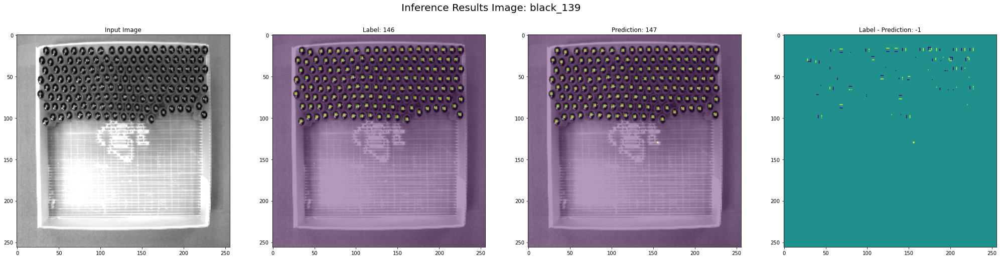

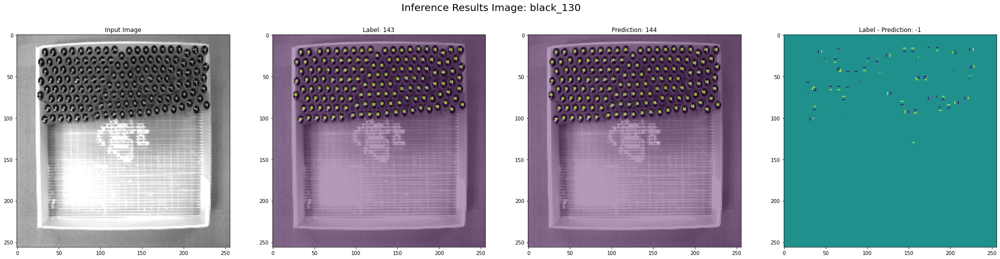

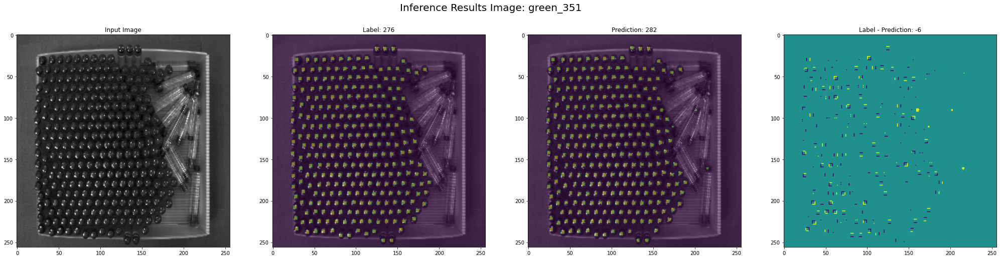

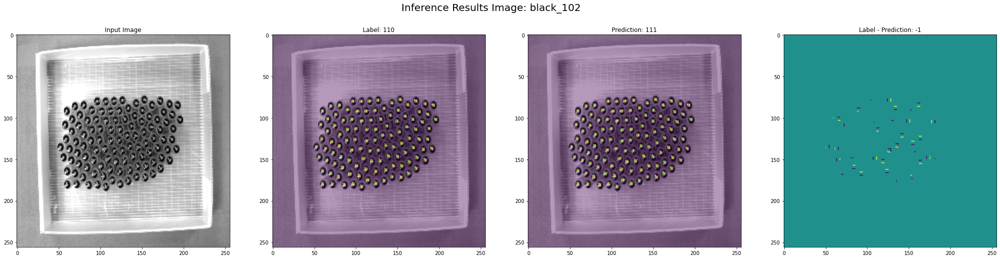

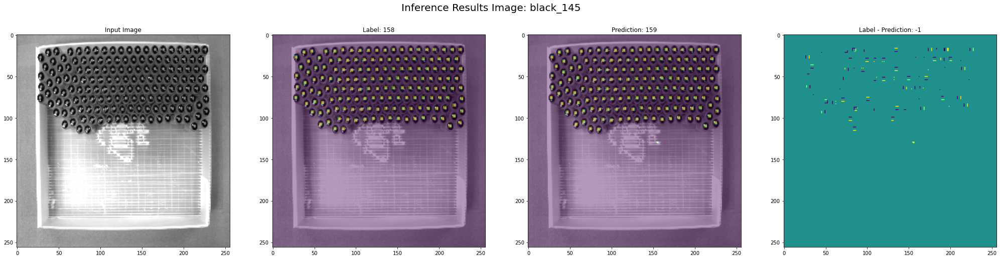

...

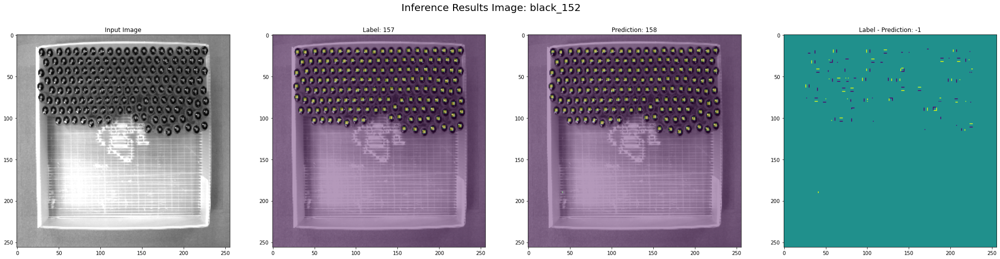

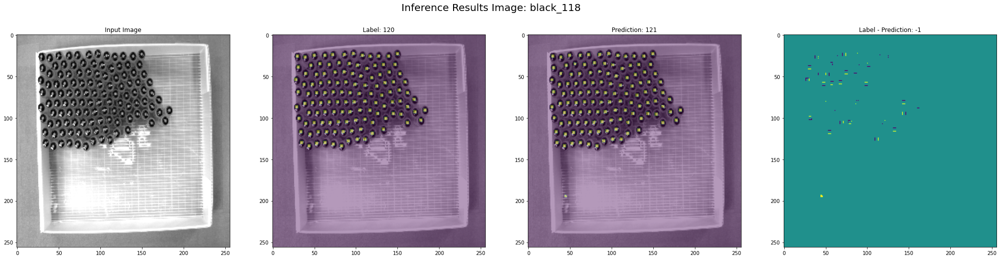

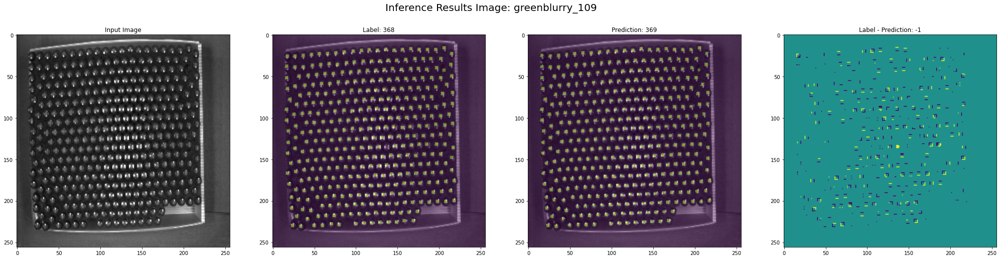

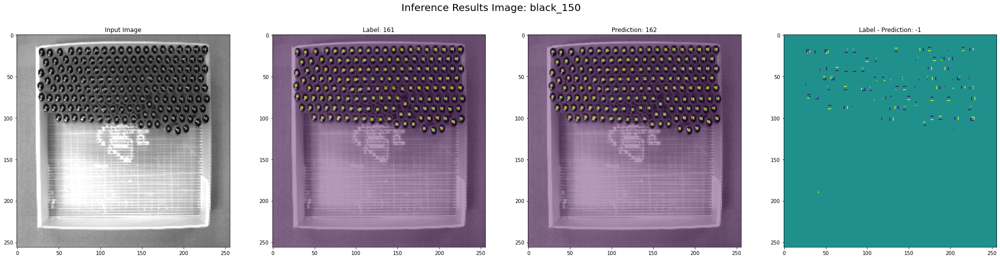

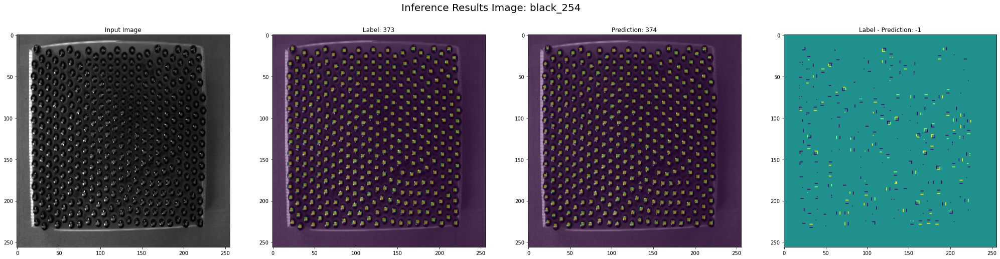

In [51]:
for image, label, prediction, name, true_count, predicted_count in worst_cases:
    # Display raw image, label, prediction, prediction - label
    fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(35, 8))
    fig.suptitle('Inference Results Image: ' + name, fontsize=20)
    axs[0].set_title('Input Image')
    axs[0].imshow(image[0][0], cmap='gray')

    axs[1].set_title('Label: ' + str(true_count))
    axs[1].imshow(image[0][0], cmap='gray')
    axs[1].imshow(label[0][0], alpha = 0.4)

    axs[2].set_title('Prediction: ' + str(predicted_count))
    axs[2].imshow(image[0][0], cmap='gray')
    axs[2].imshow(prediction[0], alpha = 0.4)
    #axs[2].imshow(prediction, alpha = 0.4) # Method 1

    axs[3].set_title('Label - Prediction: ' + str(true_count - predicted_count))
    axs[3].imshow((prediction - label[0][0].numpy())[0])
    #axs[3].imshow((prediction - label[0][0].numpy())) # Method 1

    #plt.savefig('predictions_test/' + name + '.jpg')
    #plt.close(fig)
    plt.show()